In [ ]:
!pip install torchattacks

## Importing libraries

In [332]:
# Importing libraries
import torch
import torchvision
import torchvision.transforms as transforms
import numpy as np
import json
from torch.utils.data import DataLoader
from PIL import Image
import torchattacks
import torch.nn as nn
import os
from torchattacks.attack import Attack
from tqdm import tqdm
import math
import matplotlib.pyplot as plt

In [333]:
# Setting seed values for reproducibility
seed = 42
trainer_seed = 42
os.environ['PYTHONHASHSEED'] = str(seed)
np.random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
torch.cuda.manual_seed_all(seed)
# some cudnn methods can be random even after fixing the seed
# unless you tell it to be deterministic
torch.backends.cudnn.deterministic = True

In [334]:
# Setup
device = torch.device("mps" if torch.mps.is_available() else "cuda" if torch.cuda.is_available() else "cpu")
# device = torch.device("cpu")  # Force CPU for compatibility
print("Using device:", device)

Using device: mps


## Loading Pre-trained ResNet Model and Test Data Set

In [335]:
import os
dirs = os.listdir("./TestDataSet")
dirs.remove("labels_list.json")
dirs = np.repeat(dirs , 5)
dirs = sorted(dirs)

In [336]:
# Load pretrained model
pretrained_model = torchvision.models.resnet34(weights='IMAGENET1K_V1').to(device)
pretrained_model.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [337]:
# Load labels
with open('./TestDataSet/labels_list.json', 'r') as f:
    label_map = json.load(f)
    # label_map = {int(k): v for k, v in label_map.items()}

In [338]:
# Dataset and transforms
mean_norms = np.array([0.485, 0.456, 0.406])
std_norms = np.array([0.229, 0.224, 0.225])

mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]

GLOBAL_STD_T = torch.tensor(std, device=device).view(3,1,1)

plain_transforms = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=mean_norms, std=std_norms)
])

In [339]:
dataset_path = "./TestDataSet"
dataset = torchvision.datasets.ImageFolder(root=dataset_path, transform=plain_transforms)
data_loader = DataLoader(dataset, batch_size=64, shuffle=False)\
# Labels (401-500 repeated 5 times)
labels = np.repeat(np.arange(401, 501), 5)

## Helper Functions

In [340]:
# Evaluate model performance using top-1 and top-5 accuracy metrics.
def evaluate(model, dataloader, labels):
    
    predictions = []
    
    # Run inference without gradient calculation
    with torch.no_grad():
        for batch in dataloader:
            images = batch[0].to(device)
            outputs = model(images)
            # Get top 5 predictions for each image
            _, predicted = torch.topk(outputs, 5)
            predictions.extend(predicted.cpu().numpy())
    
    predictions = np.array(predictions)
    
    # Calculate top-1 accuracy (correct prediction is first choice)
    top1 = sum(1 for x,y in zip(predictions,labels) if x[0] == y) / len(predictions)
    
    # Calculate top-5 accuracy (correct prediction is in top 5 choices)
    top5 = sum(1 for x,y in zip(predictions,labels) if y in x) / len(predictions)
    
    return top1, top5, predictions

In [341]:
# Save adversarial images while maintaining original directory structure.
def save_adversarial_dataset(adv_images, original_paths, mean, std, save_dir="./AdversarialTestSet1"):
    os.makedirs(save_dir, exist_ok=True)
    
    # Convert mean/std to tensors for denormalization
    mean_tensor = torch.from_numpy(mean).float().view(3, 1, 1)
    std_tensor = torch.from_numpy(std).float().view(3, 1, 1)
    
    for i, img_tensor in enumerate(adv_images):
        # Determine save path based on original image's directory structure
        if original_paths:
            orig_path = original_paths[i]
            class_dir = os.path.basename(os.path.dirname(orig_path))
            orig_filename = os.path.basename(orig_path)
            target_dir = os.path.join(save_dir, class_dir)
        else:
            target_dir = os.path.join(save_dir, f"class_{i}")
            orig_filename = f"img_{i}.png"
            
        os.makedirs(target_dir, exist_ok=True)
        
        # Denormalize, clamp to valid range, and convert to numpy array
        img = img_tensor.cpu() * std_tensor + mean_tensor
        img = torch.clamp(img, 0, 1)
        img = img.permute(1, 2, 0).numpy()  # Convert to HWC format
        img = (img * 255).astype(np.uint8)
        
        # Save with 'adv_' prefix to distinguish from originals
        adv_filename = f"adv_{orig_filename}"
        Image.fromarray(img).save(os.path.join(target_dir, adv_filename))

In [342]:
# Reverse normalization on image tensors and clamp to valid [0,1] range.
def denormalize_images(tensor, mean_norms, std_norms):
    tensor = tensor.clone().detach().cpu()
    mean = torch.tensor(mean_norms).view(1, -1, 1, 1)
    std = torch.tensor(std_norms).view(1, -1, 1, 1)
    tensor = tensor * std + mean  # Reverse normalization
    return torch.clamp(tensor, 0, 1)

# Normalize image tensor using channel-wise mean and std.
def normalize(tensor, mean, std):
    mean_tensor = torch.from_numpy(mean).float().view(3, 1, 1)
    std_tensor = torch.from_numpy(std).float().view(3, 1, 1)
    return (tensor - mean_tensor) / std_tensor

In [343]:
def denormalize(image):
    """Updated with proper tensor handling"""
    image = image.detach().cpu().numpy().transpose((1, 2, 0))
    image = std_norms * image + mean_norms
    return np.clip(image, 0, 1)

def visualize_adversarial_comparison(original_images, adversarial_images, 
                                    original_preds, adv_preds, true_labels, 
                                    label_map, n=3):
    # Select random indices with proper bounds checking
    sample_indices = np.random.choice(
        min(len(original_images), len(adversarial_images)), 
        size=min(n, len(original_images)), 
        replace=False
    )
    
    for idx in sample_indices:
        plt.figure(figsize=(15, 6))  # Increased width for 4 columns
        
        # Get image tensors with proper indexing
        orig_tensor = original_images[idx][0].to(device)
        adv_tensor = adversarial_images[idx][0].to(device)
        
        # Calculate noise with dimension check
        noise = adv_tensor - orig_tensor
        if noise.dim() == 3:
            noise = noise.unsqueeze(0)
        
        # Get predictions with proper tensor handling
        with torch.no_grad():
            orig_output = pretrained_model(orig_tensor.unsqueeze(0))
            orig_probs = torch.softmax(orig_output, dim=1)[0]
            
            adv_output = pretrained_model(adv_tensor.unsqueeze(0))
            adv_probs = torch.softmax(adv_output, dim=1)[0]
        
        # Create 4-column layout
        plt.subplot(1, 4, 1)
        plt.imshow(denormalize(orig_tensor))
        plt.title("Original\n"+ get_class_name(true_labels[idx], label_map))
        plt.axis('off')
        
        plt.subplot(1, 4, 2)
        plt.imshow(denormalize(adv_tensor))
        plt.title("Adversarial")
        plt.axis('off')
        
        # Noise visualization with proper normalization
        plt.subplot(1, 4, 3)
        noise_vis = noise.squeeze().cpu().numpy().transpose(1, 2, 0)
        noise_vis = (noise_vis - noise_vis.min()) / (noise_vis.max() - noise_vis.min() + 1e-8)
        plt.imshow(noise_vis, cmap='coolwarm', vmin=-1, vmax=1)
        plt.title("Perturbation")
        plt.axis('off')
        
        # Enhanced prediction display
        plt.subplot(1, 4, 4)
        _, top5 = torch.topk(adv_probs, 5)
        classes = [get_class_name(i.item(), label_map) for i in top5]
        confidences = [adv_probs[i].item()*100 for i in top5]
        
        plt.barh(classes[::-1], confidences[::-1], height=0.5)
        plt.xlim(0, 100)
        plt.title("Top Predictions")
        plt.tight_layout()
        plt.show()

def get_class_name(class_idx, label_map):
    """Unified class name handling"""
    if isinstance(label_map, dict):
        return label_map.get(str(class_idx), str(class_idx))
    if isinstance(label_map, list):
        for item in label_map:
            parts = item.split(':')
            if len(parts) >1 and str(class_idx) == parts[0].strip():
                return parts[1].strip()
    return str(class_idx)

In [344]:
# Compute L∞ norm (maximum pixel-wise difference) between original and adversarial images.

def calculate_l_inf(original_images, adv_images):
    # Denormalize both sets of images to [0,1] range
    original = denormalize_images(original_images, mean_norms, std_norms)
    adversarial = denormalize_images(adv_images, mean_norms, std_norms)
    
    # Compute absolute pixel differences
    pixel_diffs = torch.abs(original - adversarial)
    
    # Get maximum difference for each image (L∞ norm)
    return pixel_diffs.view(pixel_diffs.size(0), -1).max(dim=1)[0]

## Task 1: Evaluating ResNet model to get baseline accuracy

In [345]:
print("=== Task 1: Baseline Evaluation ===")
top1, top5, baseline_preds = evaluate(pretrained_model, data_loader, labels)
print(f"Top-1 Accuracy: {top1*100:.2f}%")
print(f"Top-5 Accuracy: {top5*100:.2f}%")

=== Task 1: Baseline Evaluation ===
Top-1 Accuracy: 76.00%
Top-5 Accuracy: 94.20%


## Task 2: Pixel-wise Attacks (FGSM)

In [346]:
class FGSM(Attack):
    """Fast Gradient Sign Method (FGSM) adversarial attack implementation.
    
    Generates adversarial examples by perturbing inputs in the direction
    of the gradient sign with magnitude epsilon.
    """

    def __init__(self, model, eps=8 / 255):
        # Initialize FGSM attack.
        super().__init__("FGSM", model)
        self.eps = eps
        self.supported_mode = ["default", "targeted"]  # Attack modes supported

    def forward(self, images, labels):
        # Generate adversarial examples for the input batch.

        
        # Ensure clean copies of inputs on correct device
        images = images.clone().detach().to(self.device)
        labels = labels.clone().detach().to(self.device)

        # Get target labels if in targeted attack mode
        if self.targeted:
            target_labels = self.get_target_label(images, labels)

        loss = nn.CrossEntropyLoss()

        # Enable gradient computation for input images
        images.requires_grad = True
        outputs = self.get_logits(images)

        # Compute loss (negative for targeted attacks)
        if self.targeted:
            cost = -loss(outputs, target_labels)  # Minimize target class probability
        else:
            cost = loss(outputs, labels)  # Maximize original class loss

        # Compute gradient of loss w.r.t. input images
        grad = torch.autograd.grad(
            cost, images, retain_graph=False, create_graph=False
        )[0]

        # Apply FGSM perturbation: x' = x + ε * sign(∇ₓJ(x,y))
        adv_images = images + self.eps * grad.sign()
        
        # Clip to maintain valid image range [0,1]
        adv_images = torch.clamp(adv_images, min=0, max=1).detach()

        return adv_images


In [347]:
def fgsm_attack(model, dataloader, labels, epsilon=0.02):
    """Generate adversarial examples using FGSM attack
    
    Args:
        model: Target model to attack
        dataloader: DataLoader containing the dataset to attack
        labels: Ground truth labels for the dataset
        epsilon: Perturbation magnitude (default: 0.02)
    """
    # Initialize FGSM attack with given parameters
    attack = FGSM(model, eps=epsilon)
    attack.set_normalization_used(mean=mean, std=std)
    
    # Storage for results
    adv_images = []
    original_paths = []  # Paths to original images
    orig_images = []     # Original images for reference
    l_inf_all_values = []  # L∞ distances for each example
    
    for batch_idx, (images, _) in enumerate(dataloader):
        # Preserve original paths if dataset provides them
        if hasattr(dataloader.dataset, 'samples'):
            start_idx = batch_idx * dataloader.batch_size
            end_idx = min((batch_idx+1)*dataloader.batch_size, len(dataloader.dataset))
            paths = [dataloader.dataset.samples[idx][0] for idx in range(start_idx, end_idx)]
            original_paths.extend(paths)
            
        # Move batch to device and get corresponding labels
        images = images.to(device)
        batch_labels = labels[start_idx:end_idx]
        batch_labels = torch.tensor(batch_labels).to(device)
        orig_images.append(images.cpu())

        # Generate adversarial examples for this batch
        adv_images_batch = attack(images, batch_labels)
        adv_images.append(adv_images_batch.cpu())

        # Calculate perturbation magnitudes (L∞ norm)
        l_inf_values = calculate_l_inf(images, adv_images_batch)
        l_inf_all_values.append(l_inf_values.cpu())
    
    # Combine all batches into single tensors
    return (
        torch.cat(adv_images, dim=0), 
        original_paths, 
        torch.cat(l_inf_all_values, dim=0)
    )

In [348]:
print("\n=== Task 2: FGSM Attack (ε=0.02) ===")
epsilon = 0.02 
adv_images_fgsm, original_paths, linf_values = fgsm_attack(pretrained_model, data_loader, labels, epsilon=epsilon)
save_adversarial_dataset(adv_images_fgsm, original_paths, mean_norms, std_norms, "./AdversarialTestSet1")

# Evaluate FGSM
fgsm_dataset = torchvision.datasets.ImageFolder(root="./AdversarialTestSet1", transform=plain_transforms)
fgsm_loader = DataLoader(fgsm_dataset, batch_size=32, shuffle=False)
top1_fgsm, top5_fgsm, fgsm_preds = evaluate(pretrained_model, fgsm_loader, labels)

print(f"FGSM Top-1 Accuracy: {top1_fgsm*100:.2f}%")
print(f"FGSM Top-5 Accuracy: {top5_fgsm*100:.2f}%")
print(f"Maximum L Infinite distance: {linf_values.max().item():.3f}")


=== Task 2: FGSM Attack (ε=0.02) ===
FGSM Top-1 Accuracy: 6.00%
FGSM Top-5 Accuracy: 31.40%
Maximum L Infinite distance: 0.020



=== Visualising images from original and adversarial datasets along with adversarial predictions ===


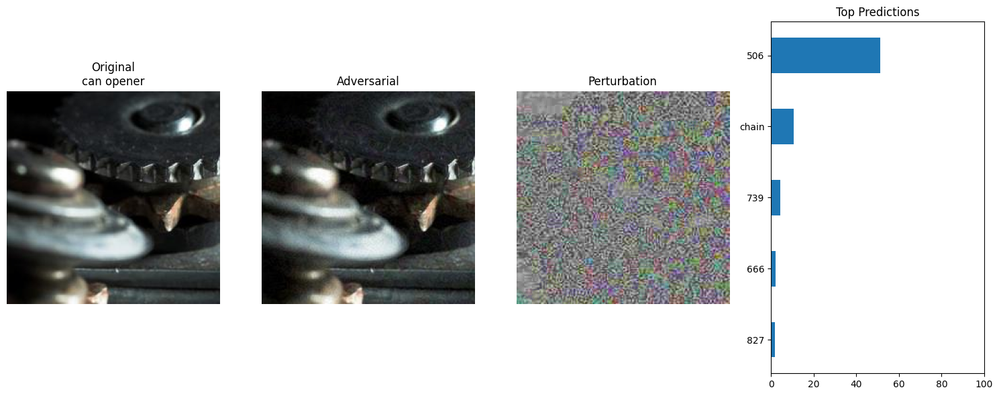

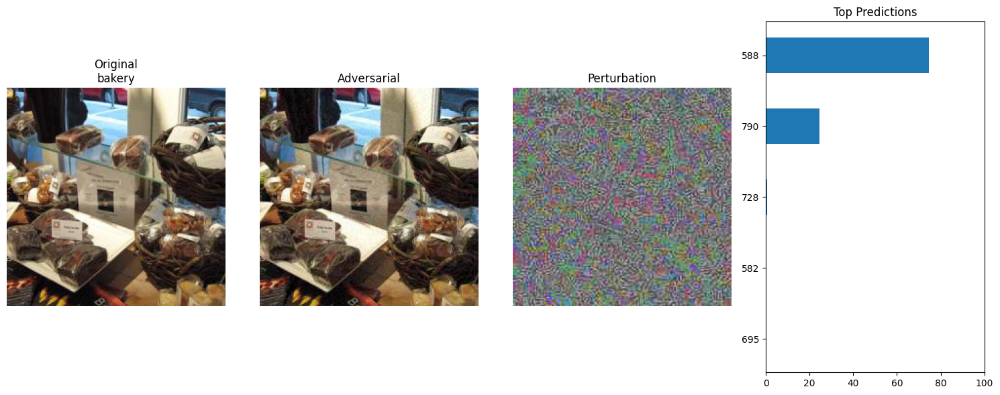

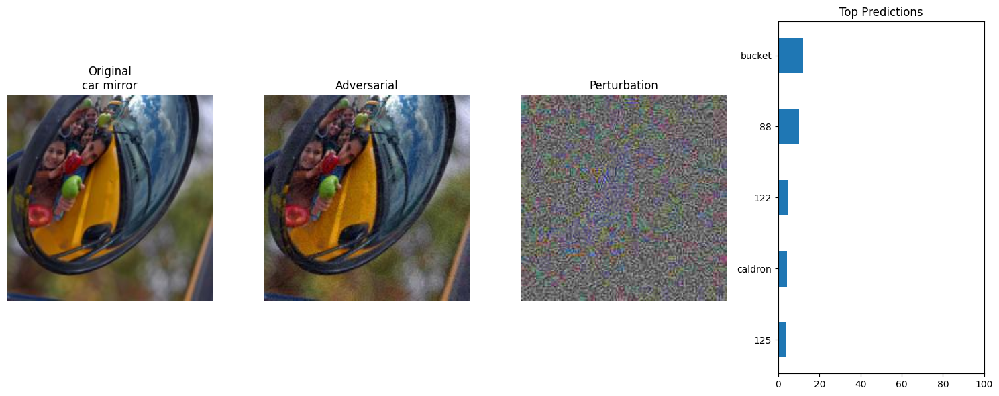

In [349]:
print("\n=== Visualising images from original and adversarial datasets along with adversarial predictions ===")
visualize_adversarial_comparison(dataset, fgsm_dataset, baseline_preds, fgsm_preds, labels, label_map, n=3)

## Task 3: Improved Attacks

- Here we will try implementing and trying different improved attacks with multiple steps or different optimizers to see if we can get better results than the FGSM attack.
  - PGD Attack
  - MIFGSM Attack: This is a multi-step attack that uses momentum to improve the attack performance.
  - Adam Optimzed PGD Attack: This is a variant of the PGD attack that uses the Adam optimizer to improve the attack performance.
  - BIM Attack: This is a variant of the FGSM attack that uses multiple steps to improve the attack performance.

### Trying PGD Attack

In [350]:
# Projected Gradient Descent (PGD) adversarial attack implementation.
class PGD(Attack):

    def __init__(self, model, eps=8/255, alpha=2/255, steps=10, random_start=True):
        # Initialize PGD attack parameters.
        super().__init__("PGD", model)
        self.eps = eps          # Maximum perturbation budget
        self.alpha = alpha      # Attack step size
        self.steps = steps      # Number of attack iterations
        self.random_start = random_start  # Random initialization
        self.supported_mode = ["default", "targeted"]

    def forward(self, images, labels):
        # Generate adversarial examples using iterative PGD.
        # Ensure clean copies of inputs on correct device
        images = images.clone().detach().to(self.device)
        labels = labels.clone().detach().to(self.device)

        # Get target labels if in targeted attack mode
        if self.targeted:
            target_labels = self.get_target_label(images, labels)

        loss = nn.CrossEntropyLoss()
        adv_images = images.clone().detach()

        # Random initialization within epsilon ball
        if self.random_start:
            adv_images = adv_images + torch.empty_like(adv_images).uniform_(
                -self.eps, self.eps
            )
            adv_images = torch.clamp(adv_images, min=0, max=1).detach()

        # Perform PGD iterations
        for _ in range(self.steps):
            adv_images.requires_grad = True
            outputs = self.get_logits(adv_images)

            # Compute loss (negative for targeted attacks)
            if self.targeted:
                cost = -loss(outputs, target_labels)  # Minimize target class probability
            else:
                cost = loss(outputs, labels)  # Maximize original class loss

            # Compute gradient of loss w.r.t. adversarial images
            grad = torch.autograd.grad(
                cost, adv_images, retain_graph=False, create_graph=False
            )[0]

            # Update with gradient sign and project to epsilon ball
            adv_images = adv_images.detach() + self.alpha * grad.sign()
            delta = torch.clamp(adv_images - images, min=-self.eps, max=self.eps)
            adv_images = torch.clamp(images + delta, min=0, max=1).detach()

        return adv_images

In [351]:
def pgd_attack(model, dataloader, labels, epsilon=0.02, alpha = 0.002, steps = 20, random_start = True):
    """Generate adversarial examples using PGD attack 
    
    Args:
        model: Target model to attack
        dataloader: DataLoader containing the dataset to attack
        labels: Ground truth labels for the dataset
        epsilon: Perturbation magnitude (default: 0.02)
    """
    # Initialize FGSM attack with given parameters
    attack = PGD(model, eps=epsilon , alpha=alpha, steps=steps, random_start=random_start)
    attack.set_normalization_used(mean=mean, std=std)
    
    # Storage for results
    adv_images = []
    original_paths = []  # Paths to original images
    orig_images = []     # Original images for reference
    l_inf_all_values = []  # L∞ distances for each example
    
    for batch_idx, (images, _) in enumerate(dataloader):
        # Preserve original paths if dataset provides them
        if hasattr(dataloader.dataset, 'samples'):
            start_idx = batch_idx * dataloader.batch_size
            end_idx = min((batch_idx+1)*dataloader.batch_size, len(dataloader.dataset))
            paths = [dataloader.dataset.samples[idx][0] for idx in range(start_idx, end_idx)]
            original_paths.extend(paths)
            
        # Move batch to device and get corresponding labels
        images = images.to(device)
        batch_labels = labels[start_idx:end_idx]
        batch_labels = torch.tensor(batch_labels).to(device)
        orig_images.append(images.cpu())

        # Generate adversarial examples for this batch
        adv_images_batch = attack(images, batch_labels)
        adv_images.append(adv_images_batch.cpu())

        # Calculate perturbation magnitudes (L∞ norm)
        l_inf_values = calculate_l_inf(images, adv_images_batch)
        l_inf_all_values.append(l_inf_values.cpu())
    
    # Combine all batches into single tensors
    return (
        torch.cat(adv_images, dim=0), 
        original_paths, 
        torch.cat(l_inf_all_values, dim=0)
    )

In [352]:
print("\n=== Task 3: Improved Attack PGD (ε=0.02) with alpha 0.002 and iterations as 20 ===")
epsilon = 0.02 
adv_images_pgd, original_paths, linf_values = pgd_attack(pretrained_model, data_loader, labels, epsilon=epsilon, alpha = 0.002, steps = 20, random_start = False)
save_adversarial_dataset(adv_images_pgd, original_paths, mean_norms, std_norms, "./AdversarialTestSet2-1")

# Evaluate pgd
pgd_dataset = torchvision.datasets.ImageFolder(root="./AdversarialTestSet2-1", transform=plain_transforms)
pgd_loader = DataLoader(pgd_dataset, batch_size=32, shuffle=False)
top1_pgd, top5_pgd, pgd_preds = evaluate(pretrained_model, pgd_loader, labels)

print(f"PGD Top-1 Accuracy: {top1_pgd*100:.2f}%")
print(f"PGD Top-5 Accuracy: {top5_pgd*100:.2f}%")
print(f"Maximum L Infinite distance: {linf_values.max().item():.3f}")


=== Task 3: Improved Attack PGD (ε=0.02) with alpha 0.002 and iterations as 20 ===
PGD Top-1 Accuracy: 0.60%
PGD Top-5 Accuracy: 30.80%
Maximum L Infinite distance: 0.020



=== Visualising images from original and adversarial datasets along with adversarial predictions ===


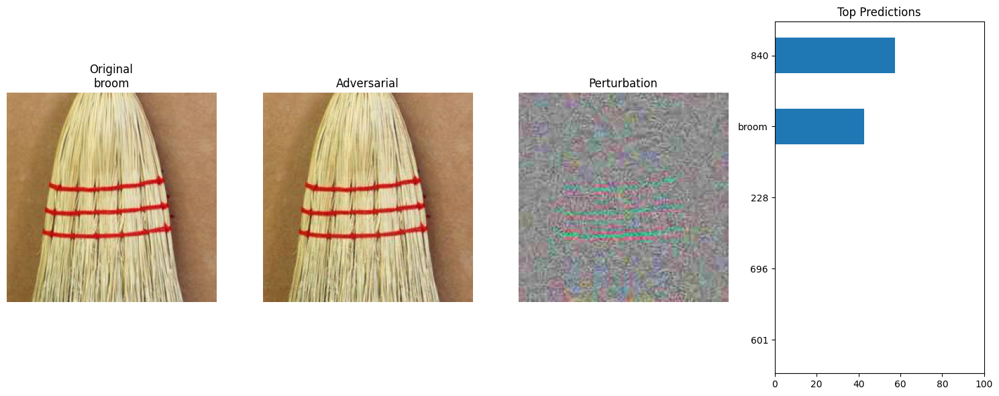

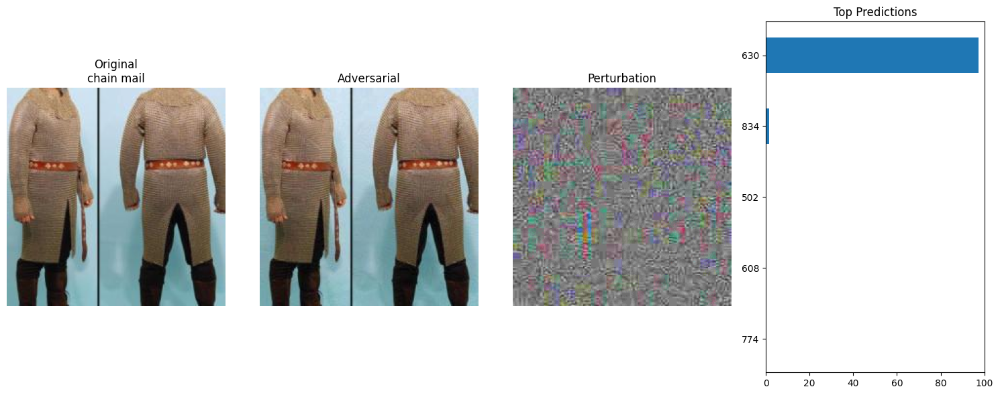

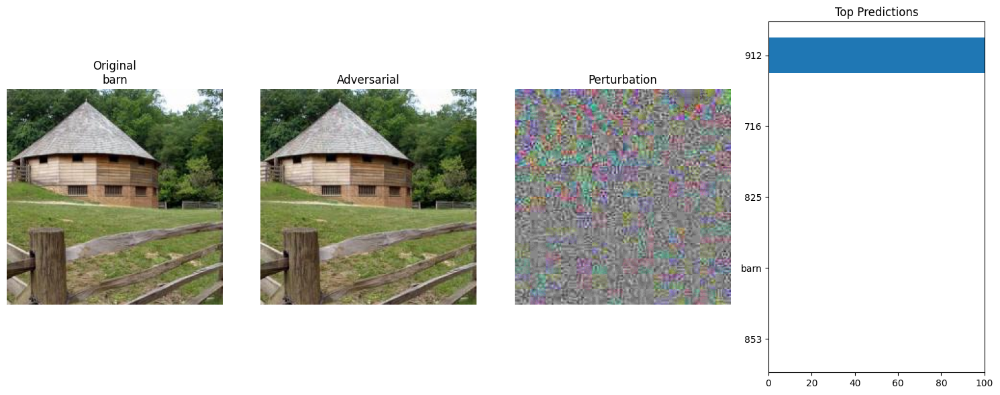

In [353]:
print("\n=== Visualising images from original and adversarial datasets along with adversarial predictions ===")
visualize_adversarial_comparison(dataset, pgd_dataset, baseline_preds, pgd_preds, labels, label_map, n=3)

In [354]:
print("\n=== Task 3: Improved Attack PGD (ε=0.02) with alpha 0.004 and iterations as 15 ===")
epsilon = 0.02 
adv_images_pgd, original_paths, linf_values = pgd_attack(pretrained_model, data_loader, labels, epsilon=epsilon, alpha = 0.004, steps = 15, random_start = False)
save_adversarial_dataset(adv_images_pgd, original_paths, mean_norms, std_norms, "./AdversarialTestSet2-2")

# Evaluate pgd
pgd_dataset = torchvision.datasets.ImageFolder(root="./AdversarialTestSet2-2", transform=plain_transforms)
pgd_loader = DataLoader(pgd_dataset, batch_size=32, shuffle=False)
top1_pgd, top5_pgd, pgd_preds = evaluate(pretrained_model, pgd_loader, labels)

print(f"PGD Top-1 Accuracy: {top1_pgd*100:.2f}%")
print(f"PGD Top-5 Accuracy: {top5_pgd*100:.2f}%")
print(f"Maximum L Infinite distance: {linf_values.max().item():.3f}")


=== Task 3: Improved Attack PGD (ε=0.02) with alpha 0.004 and iterations as 15 ===
PGD Top-1 Accuracy: 0.00%
PGD Top-5 Accuracy: 25.60%
Maximum L Infinite distance: 0.020



=== Visualising images from original and adversarial datasets along with adversarial predictions ===


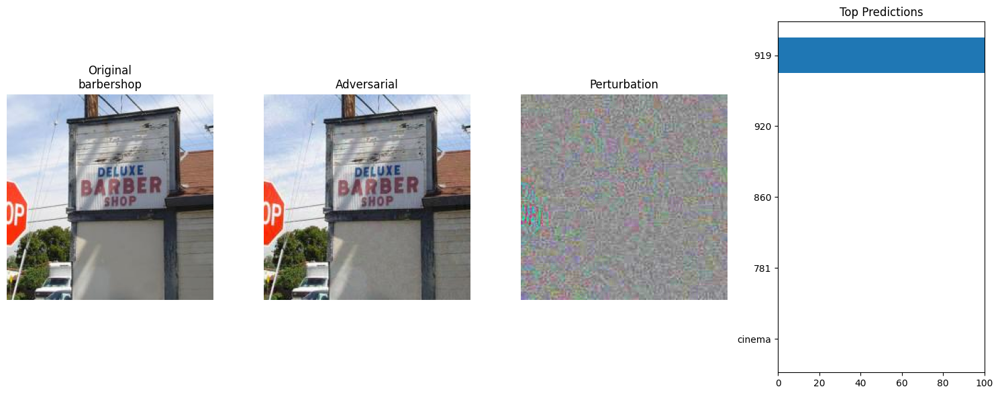

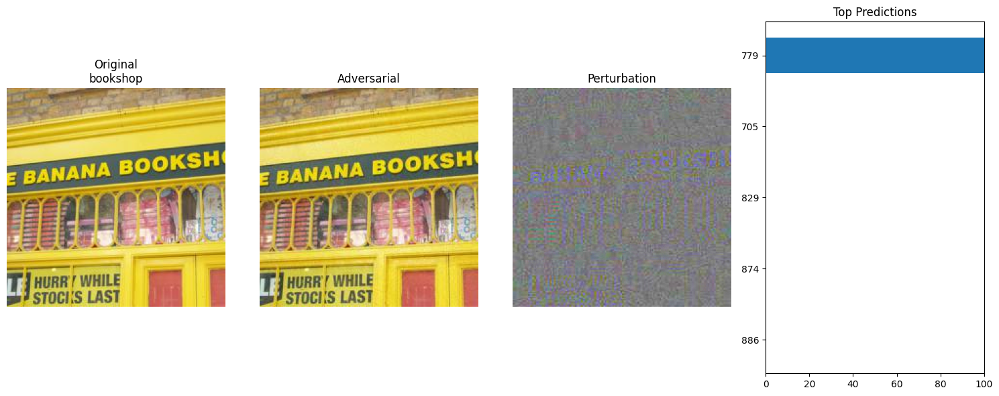

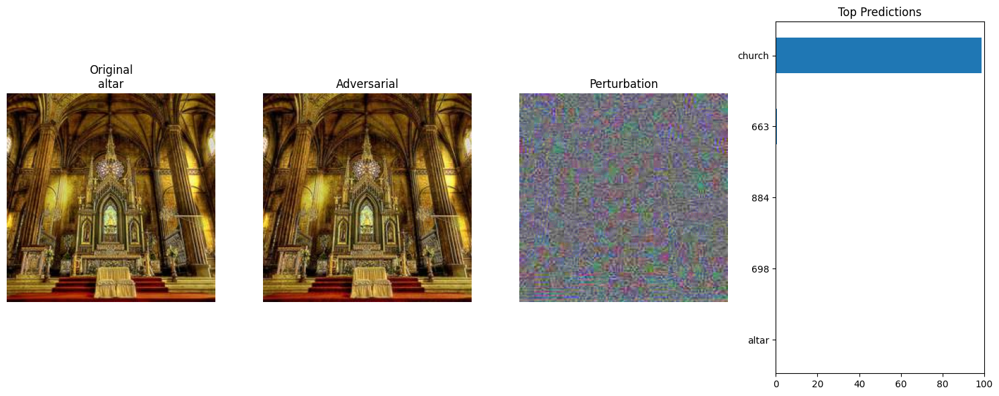

In [355]:
print("\n=== Visualising images from original and adversarial datasets along with adversarial predictions ===")
visualize_adversarial_comparison(dataset, pgd_dataset, baseline_preds, pgd_preds, labels, label_map, n=3)

### Adam Optimized PGD Attack

In [356]:
class AdamPGD(Attack):
    """Adam-PGD: PGD attack with Adam-style gradient updates.
    
    Combines Projected Gradient Descent with Adam optimizer's adaptive moment estimation
    for potentially more effective adversarial perturbations.
    """

    def __init__(self, model, eps=8/255, alpha=2/255, steps=10, random_start=True):
        """Initialize Adam-PGD attack parameters.
        
        Args:
            model: Target model to attack
            eps: Maximum perturbation allowed (L∞ norm)
            alpha: Learning rate/step size for each iteration
            steps: Number of attack iterations
            random_start: Whether to initialize with random perturbations
        """
        super().__init__("AdamPGD", model)  # Changed name to reflect Adam variant
        self.eps = eps          # Maximum perturbation budget
        self.alpha = alpha      # Base step size
        self.steps = steps      # Number of iterations
        self.random_start = random_start
        
        # Adam-specific parameters
        self.beta1 = 0.9       # Exponential decay rate for 1st moment estimates
        self.beta2 = 0.999     # Exponential decay rate for 2nd moment estimates
        self.epsilon = 1e-8    # Numerical stability term
        self.supported_mode = ["default", "targeted"]

    def forward(self, images, labels):
        """Generate adversarial examples using Adam-optimized PGD.
        
        Args:
            images: Batch of original images (N,C,H,W)
            labels: Ground truth or target labels
        """
        # Initialize tensors and move to device
        images = images.clone().detach().to(self.device)
        labels = labels.clone().detach().to(self.device)
        
        # Adam momentum buffers
        m = torch.zeros_like(images).to(self.device)  # First moment (mean)
        v = torch.zeros_like(images).to(self.device)  # Second moment (uncentered variance)

        # Targeted attack setup
        if self.targeted:
            target_labels = self.get_target_label(images, labels)

        loss = nn.CrossEntropyLoss()
        adv_images = images.clone().detach()

        # Random initialization within epsilon ball
        if self.random_start:
            adv_images = adv_images + torch.empty_like(adv_images).uniform_(
                -self.eps, self.eps
            )
            adv_images = torch.clamp(adv_images, min=0, max=1).detach()

        # Adam-PGD iterations
        for itr in range(self.steps):
            adv_images.requires_grad = True
            outputs = self.get_logits(adv_images)

            # Compute loss (negative for targeted attacks)
            if self.targeted:
                cost = -loss(outputs, target_labels)
            else:
                cost = loss(outputs, labels)

            # Get gradient of loss w.r.t. inputs
            grad = torch.autograd.grad(
                cost, adv_images, retain_graph=False, create_graph=False
            )[0]
            
            # Normalize gradients by mean absolute value
            grad = grad / torch.mean(torch.abs(grad), dim=(1,2,3), keepdim=True)
            
            # Adam moment updates
            m = self.beta1 * m + (1 - self.beta1) * grad  # Update biased 1st moment
            v = self.beta2 * v + (1 - self.beta2) * (grad ** 2)  # Update biased 2nd moment
            
            # Bias correction (account for initialization bias)
            m_hat = m / (1 - self.beta1 ** (itr + 1))
            v_hat = v / (1 - self.beta2 ** (itr + 1))
            
            # Compute Adam-scaled gradient with numerical stability
            adam_grad = m_hat / (torch.sqrt(v_hat) + self.epsilon)

            # Update and project to epsilon ball
            adv_images = adv_images.detach() + self.alpha * adam_grad.sign()
            delta = torch.clamp(adv_images - images, min=-self.eps, max=self.eps)
            adv_images = torch.clamp(images + delta, min=0, max=1).detach()

        return adv_images

In [357]:
def adam_pgd_attack(model, dataloader, labels, epsilon=0.02, alpha = 0.002, steps = 20, random_start = True):
    """Generate adversarial examples using Adam Optimized PGD attack 
    
    Args:
        model: Target model to attack
        dataloader: DataLoader containing the dataset to attack
        labels: Ground truth labels for the dataset
        epsilon: Perturbation magnitude (default: 0.02)
    """
    # Initialize FGSM attack with given parameters
    attack = AdamPGD(model, eps=epsilon , alpha=alpha, steps=steps, random_start=random_start)
    attack.set_normalization_used(mean=mean, std=std)
    
    # Storage for results
    adv_images = []
    original_paths = []  # Paths to original images
    orig_images = []     # Original images for reference
    l_inf_all_values = []  # L∞ distances for each example
    
    for batch_idx, (images, _) in enumerate(dataloader):
        # Preserve original paths if dataset provides them
        if hasattr(dataloader.dataset, 'samples'):
            start_idx = batch_idx * dataloader.batch_size
            end_idx = min((batch_idx+1)*dataloader.batch_size, len(dataloader.dataset))
            paths = [dataloader.dataset.samples[idx][0] for idx in range(start_idx, end_idx)]
            original_paths.extend(paths)
            
        # Move batch to device and get corresponding labels
        images = images.to(device)
        batch_labels = labels[start_idx:end_idx]
        batch_labels = torch.tensor(batch_labels).to(device)
        orig_images.append(images.cpu())

        # Generate adversarial examples for this batch
        adv_images_batch = attack(images, batch_labels)
        adv_images.append(adv_images_batch.cpu())

        # Calculate perturbation magnitudes (L∞ norm)
        l_inf_values = calculate_l_inf(images, adv_images_batch)
        l_inf_all_values.append(l_inf_values.cpu())
    
    # Combine all batches into single tensors
    return (
        torch.cat(adv_images, dim=0), 
        original_paths, 
        torch.cat(l_inf_all_values, dim=0)
    )

In [ ]:
print("\n=== Task 3: Improved Attack using Adam optimized PGD (ε=0.02) with alpha 0.002 and iterations as 10 ===")
epsilon = 0.02 
adv_images_adam_pgd, original_paths, linf_values = adam_pgd_attack(pretrained_model, data_loader, labels, epsilon=epsilon, alpha = 0.002, steps = 10, random_start = False)
save_adversarial_dataset(adv_images_adam_pgd, original_paths, mean_norms, std_norms, "./AdversarialTestSet2-3")

# Evaluate pgd
adam_pgd_dataset = torchvision.datasets.ImageFolder(root="./AdversarialTestSet2-3", transform=plain_transforms)
adam_pgd_loader = DataLoader(adam_pgd_dataset, batch_size=32, shuffle=False)
top1_adam_pgd, top5_adam_pgd, adam_pgd_preds = evaluate(pretrained_model, adam_pgd_loader, labels)

print(f"Adam PGD Top-1 Accuracy: {top1_adam_pgd*100:.2f}%")
print(f"Adam PGD Top-5 Accuracy: {top5_adam_pgd*100:.2f}%")
print(f"Maximum L Infinite distance: {linf_values.max().item():.3f}")


=== Task 3: Improved Attack using Adam optimized PGD (ε=0.02) with alpha 0.002 and iterations as 10 ===



=== Visualising images from original and adversarial datasets along with adversarial predictions ===


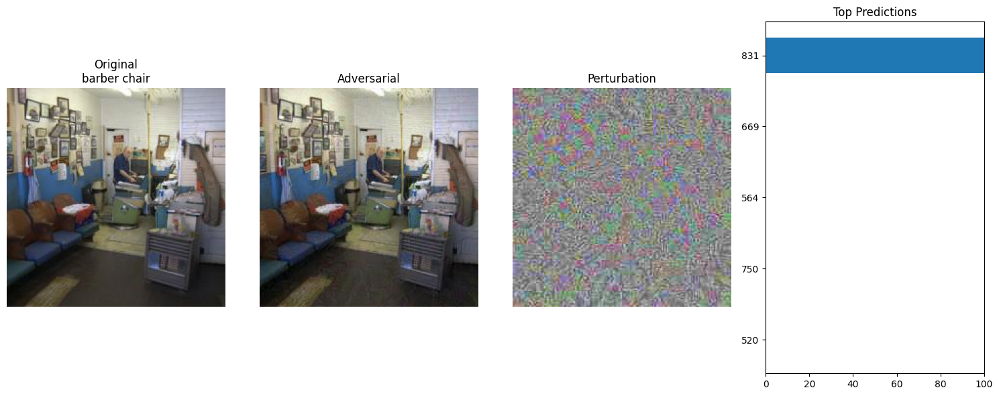

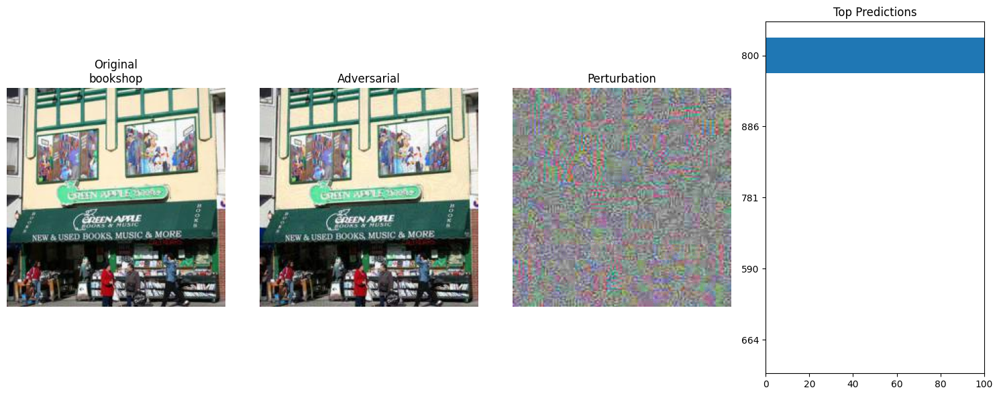

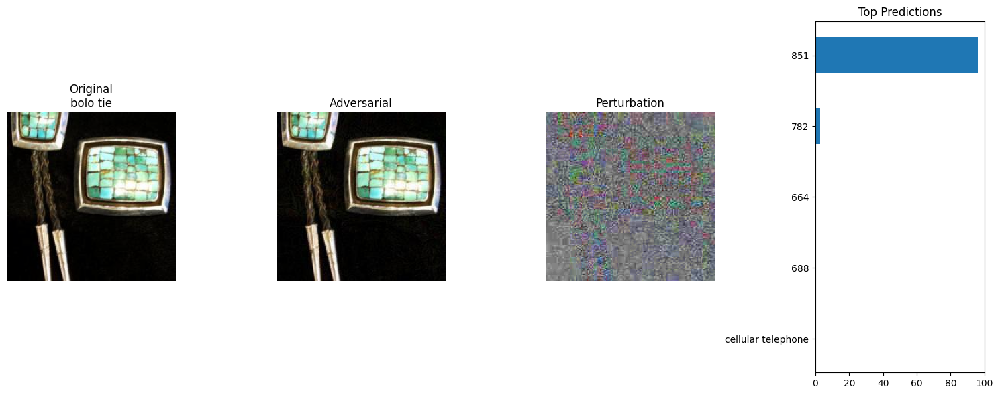

In [ ]:
print("\n=== Visualising images from original and adversarial datasets along with adversarial predictions ===")
visualize_adversarial_comparison(dataset, adam_pgd_dataset, baseline_preds, adam_pgd_preds, labels, label_map, n=3)

### Momentum Iterative FGSM Attack

In [ ]:
class MIFGSM(Attack):
    """Momentum Iterative Fast Gradient Sign Method (MI-FGSM) attack.
    
    Enhances the basic iterative attack by incorporating momentum to stabilize update
    directions and escape poor local maxima during the attack process.
    """

    def __init__(self, model, eps=8/255, alpha=2/255, steps=10, decay=1.0):
        """Initialize MI-FGSM attack parameters.
        
        Args:
            model: Target model to attack
            eps: Maximum perturbation allowed (L∞ norm)
            alpha: Step size for each iteration
            steps: Number of attack iterations
            decay: Momentum decay factor (1.0 = no decay)
        """
        super().__init__("MIFGSM", model)
        self.eps = eps          # Maximum perturbation budget
        self.alpha = alpha      # Attack step size
        self.steps = steps      # Number of attack iterations
        self.decay = decay      # Momentum decay factor
        self.supported_mode = ["default", "targeted"]

    def forward(self, images, labels):
        """Generate adversarial examples using momentum-based iterative FGSM.
        
        Args:
            images: Batch of original images (N,C,H,W)
            labels: Ground truth or target labels
            
        Returns:
            Adversarial images with L∞ norm ≤ eps
        """
        # Initialize tensors and move to device
        images = images.clone().detach().to(self.device)
        labels = labels.clone().detach().to(self.device)

        # Initialize momentum buffer
        momentum = torch.zeros_like(images).detach().to(self.device)
        loss = nn.CrossEntropyLoss()
        adv_images = images.clone().detach()

        # Targeted attack setup
        if self.targeted:
            target_labels = self.get_target_label(images, labels)

        # MI-FGSM iterations
        for _ in range(self.steps):
            adv_images.requires_grad = True
            outputs = self.get_logits(adv_images)

            # Compute loss (negative for targeted attacks)
            if self.targeted:
                cost = -loss(outputs, target_labels)  # Minimize target class probability
            else:
                cost = loss(outputs, labels)  # Maximize original class loss

            # Get gradient of loss w.r.t. inputs
            grad = torch.autograd.grad(
                cost, adv_images, retain_graph=False, create_graph=False
            )[0]

            # Normalize gradients and accumulate momentum
            grad = grad / torch.mean(torch.abs(grad), dim=(1, 2, 3), keepdim=True)
            grad = grad + momentum * self.decay
            momentum = grad  # Update momentum buffer

            # Update and project to epsilon ball
            adv_images = adv_images.detach() + self.alpha * grad.sign()
            delta = torch.clamp(adv_images - images, min=-self.eps, max=self.eps)
            adv_images = torch.clamp(images + delta, min=0, max=1).detach()

        return adv_images

In [ ]:
def mifgsm_attack(model, dataloader, labels, epsilon=0.02, alpha = 0.002, steps = 10, decay = 0.9):
    """Generate adversarial examples using Adam Optimized PGD attack 
    
    Args:
        model: Target model to attack
        dataloader: DataLoader containing the dataset to attack
        labels: Ground truth labels for the dataset
        epsilon: Perturbation magnitude (default: 0.02)
    """
    # Initialize FGSM attack with given parameters
    attack = MIFGSM(model, eps=epsilon , steps=steps, alpha= alpha, decay=decay)
    attack.set_normalization_used(mean=mean, std=std)
    
    # Storage for results
    adv_images = []
    original_paths = []  # Paths to original images
    orig_images = []     # Original images for reference
    l_inf_all_values = []  # L∞ distances for each example
    
    for batch_idx, (images, _) in enumerate(dataloader):
        # Preserve original paths if dataset provides them
        if hasattr(dataloader.dataset, 'samples'):
            start_idx = batch_idx * dataloader.batch_size
            end_idx = min((batch_idx+1)*dataloader.batch_size, len(dataloader.dataset))
            paths = [dataloader.dataset.samples[idx][0] for idx in range(start_idx, end_idx)]
            original_paths.extend(paths)
            
        # Move batch to device and get corresponding labels
        images = images.to(device)
        batch_labels = labels[start_idx:end_idx]
        batch_labels = torch.tensor(batch_labels).to(device)
        orig_images.append(images.cpu())

        # Generate adversarial examples for this batch
        adv_images_batch = attack(images, batch_labels)
        adv_images.append(adv_images_batch.cpu())

        # Calculate perturbation magnitudes (L∞ norm)
        l_inf_values = calculate_l_inf(images, adv_images_batch)
        l_inf_all_values.append(l_inf_values.cpu())
    
    # Combine all batches into single tensors
    return (
        torch.cat(adv_images, dim=0), 
        original_paths, 
        torch.cat(l_inf_all_values, dim=0)
    )

In [ ]:
# Task 3: Improved Attack (Moment Iterative FGSM)

print("\n=== Task 3: Moment Iterative FGSM Attack (ε=0.02) with alpha = 0.002 and interations as 10 ===")
epsilon = 0.02 
adv_images_moment_fgsm, original_paths, linf_values = mifgsm_attack(pretrained_model, data_loader, labels, epsilon=epsilon, alpha = 0.002, steps = 10)
save_adversarial_dataset(adv_images_moment_fgsm, original_paths, mean_norms, std_norms, "./AdversarialTestSet2")

# Evaluate pgd
moment_fgsm_dataset = torchvision.datasets.ImageFolder(root="./AdversarialTestSet2", transform=plain_transforms)
moment_fgsm_loader = DataLoader(moment_fgsm_dataset, batch_size=32, shuffle=False)
top1_moment_fgsm, top5_moment_fgsm, moment_fgsm_preds = evaluate(pretrained_model, moment_fgsm_loader, labels)

print(f"MIFGSM Top-1 Accuracy: {top1_moment_fgsm*100:.2f}%")
print(f"MIFGSM Top-5 Accuracy: {top5_moment_fgsm*100:.2f}%")
print(f"Maximum L Infinite distance: {linf_values.max().item():.3f}")


=== Task 3: Moment Iterative FGSM Attack (ε=0.02) with alpha = 0.002 and interations as 10 ===
PGD Top-1 Accuracy: 0.00%
PGD Top-5 Accuracy: 10.80%
Maximum L Infinite distance: 0.020



=== Visualising images from original and adversarial datasets along with adversarial predictions ===


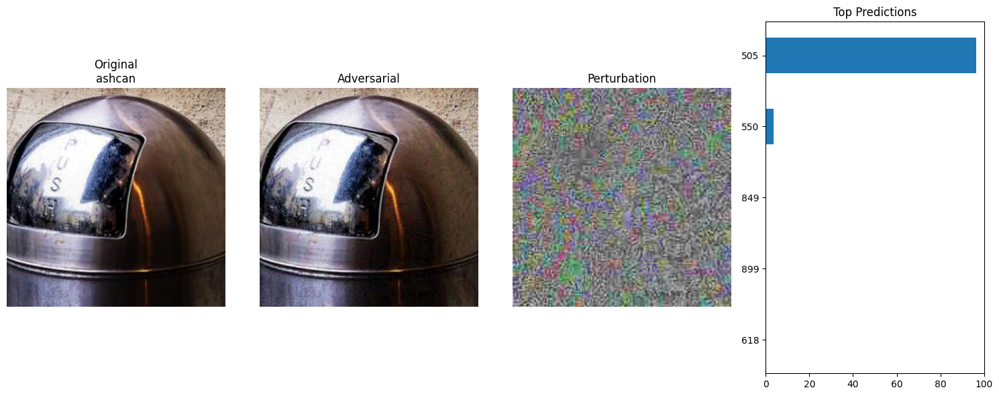

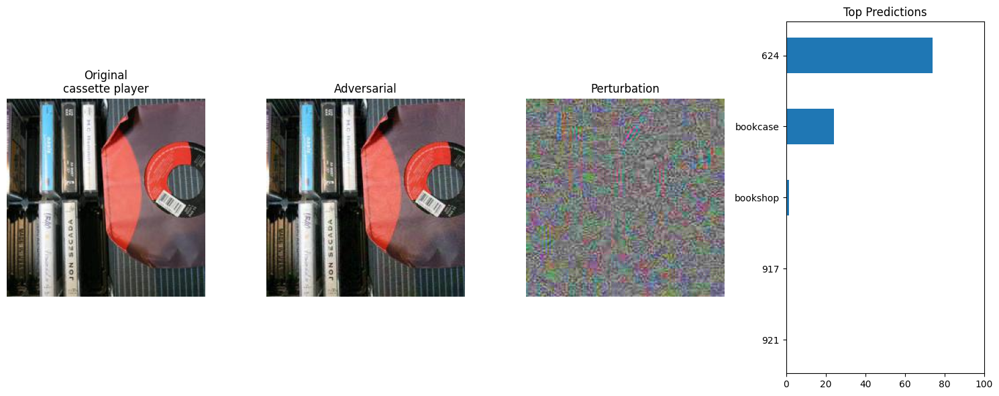

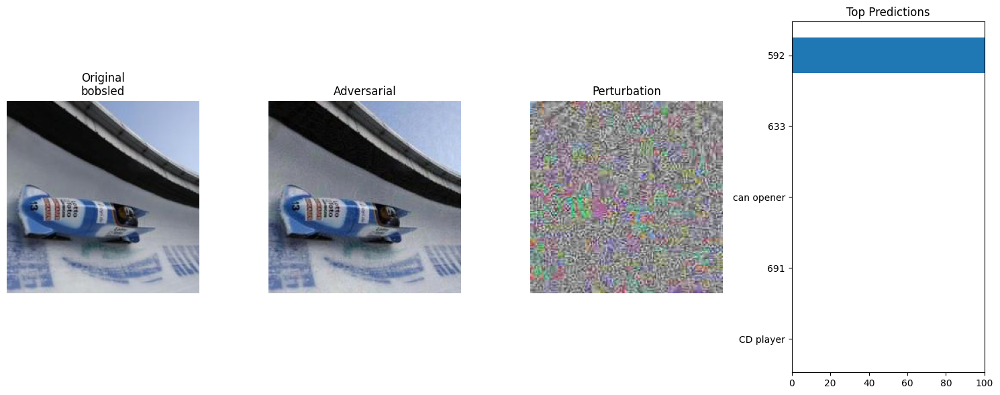

In [ ]:
print("\n=== Visualising images from original and adversarial datasets along with adversarial predictions ===")
visualize_adversarial_comparison(dataset, moment_fgsm_dataset, baseline_preds, moment_fgsm_preds, labels, label_map, n=3)

In [ ]:
# Task 3: Improved Attack (Moment Iterative FGSM)

print("\n=== Task 3: Moment Iterative FGSM Attack (ε=0.02) with alpha = 0.002 and interations as 20 ===")
epsilon = 0.02 
adv_images_moment_fgsm, original_paths, linf_values = mifgsm_attack(pretrained_model, data_loader, labels, epsilon=epsilon, alpha = 0.002, steps = 20)
save_adversarial_dataset(adv_images_moment_fgsm, original_paths, mean_norms, std_norms, "./AdversarialTestSet2-4")

# Evaluate pgd
moment_fgsm_dataset = torchvision.datasets.ImageFolder(root="./AdversarialTestSet2-4", transform=plain_transforms)
moment_fgsm_loader = DataLoader(moment_fgsm_dataset, batch_size=32, shuffle=False)
top1_moment_fgsm, top5_moment_fgsm, moment_fgsm_preds = evaluate(pretrained_model, moment_fgsm_loader, labels)

print(f"MIFGSM Top-1 Accuracy: {top1_moment_fgsm*100:.2f}%")
print(f"MIFGSM Top-5 Accuracy: {top5_moment_fgsm*100:.2f}%")
print(f"Maximum L Infinite distance: {linf_values.max().item():.3f}")


=== Task 3: Moment Iterative FGSM Attack (ε=0.02) with alpha = 0.002 and interations as 20 ===
PGD Top-1 Accuracy: 0.00%
PGD Top-5 Accuracy: 13.80%
Maximum L Infinite distance: 0.020



=== Visualising images from original and adversarial datasets along with adversarial predictions ===


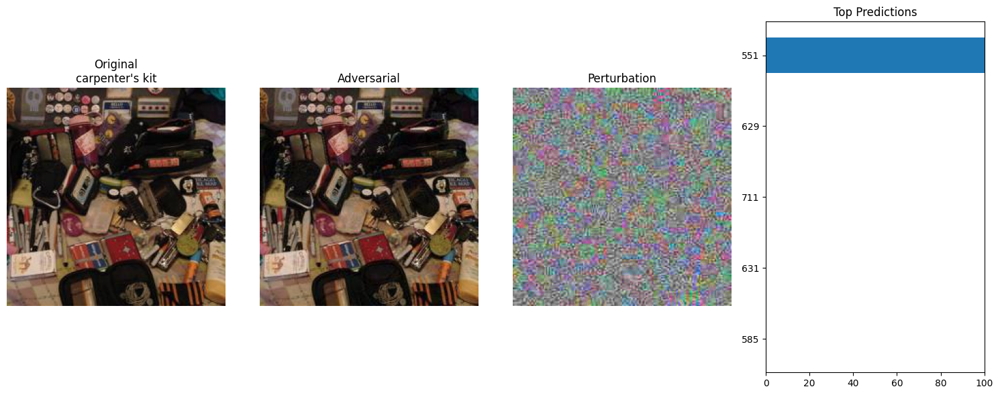

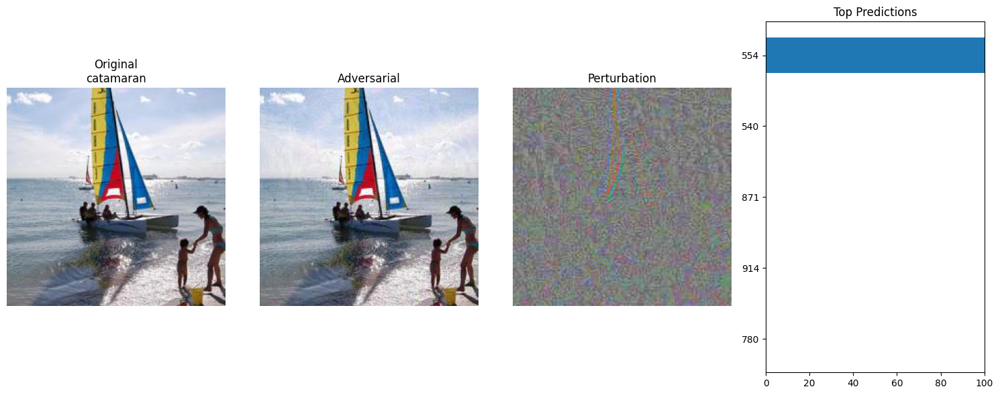

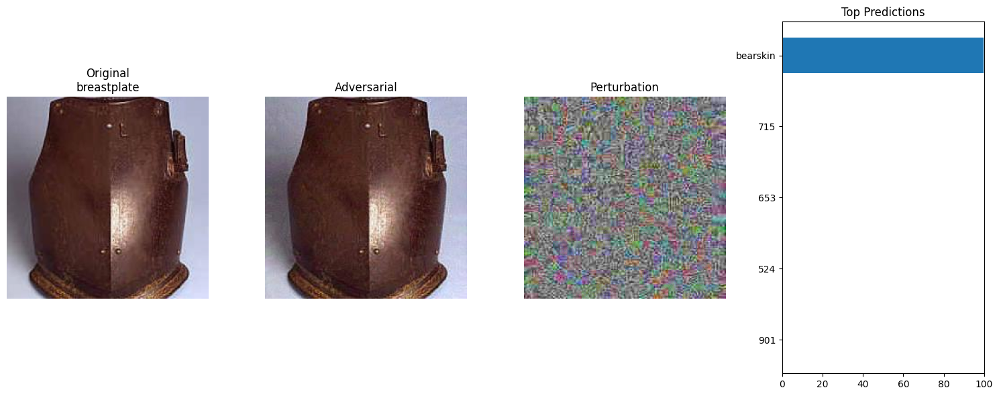

In [ ]:
print("\n=== Visualising images from original and adversarial datasets along with adversarial predictions ===")
visualize_adversarial_comparison(dataset, moment_fgsm_dataset, baseline_preds, moment_fgsm_preds, labels, label_map, n=3)

In [ ]:
# Task 3: Improved Attack (Moment Iterative FGSM)

print("\n=== Task 3: Moment Iterative FGSM Attack (ε=0.02) with alpha = 0.002 and interations as 30 ===")
epsilon = 0.02 
adv_images_moment_fgsm, original_paths, linf_values = mifgsm_attack(pretrained_model, data_loader, labels, epsilon=epsilon, alpha = 0.002, steps = 30)
save_adversarial_dataset(adv_images_moment_fgsm, original_paths, mean_norms, std_norms, "./AdversarialTestSet2-5")

# Evaluate pgd
moment_fgsm_dataset = torchvision.datasets.ImageFolder(root="./AdversarialTestSet2-5", transform=plain_transforms)
moment_fgsm_loader = DataLoader(moment_fgsm_dataset, batch_size=32, shuffle=False)
top1_moment_fgsm, top5_moment_fgsm, moment_fgsm_preds = evaluate(pretrained_model, moment_fgsm_loader, labels)

print(f"PGD Top-1 Accuracy: {top1_moment_fgsm*100:.2f}%")
print(f"PGD Top-5 Accuracy: {top5_moment_fgsm*100:.2f}%")
print(f"Maximum L Infinite distance: {linf_values.max().item():.3f}")


=== Task 3: Moment Iterative FGSM Attack (ε=0.02) with alpha = 0.002 and interations as 30 ===
PGD Top-1 Accuracy: 0.20%
PGD Top-5 Accuracy: 18.40%
Maximum L Infinite distance: 0.020



=== Visualising images from original and adversarial datasets along with adversarial predictions ===


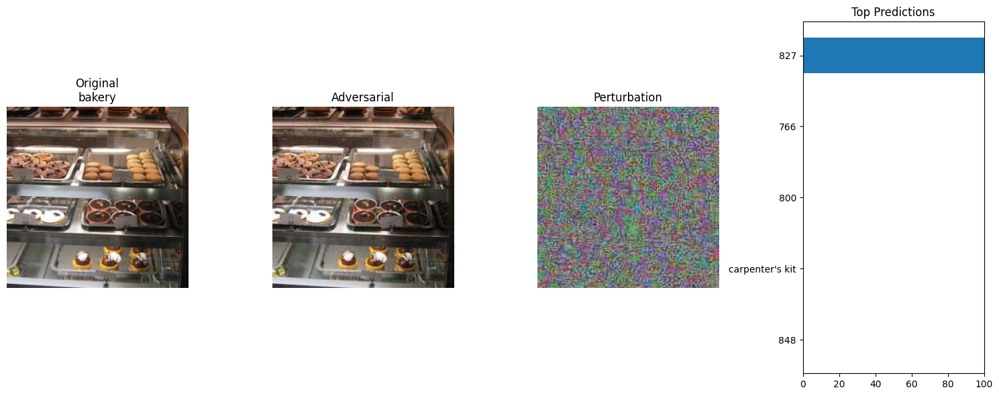

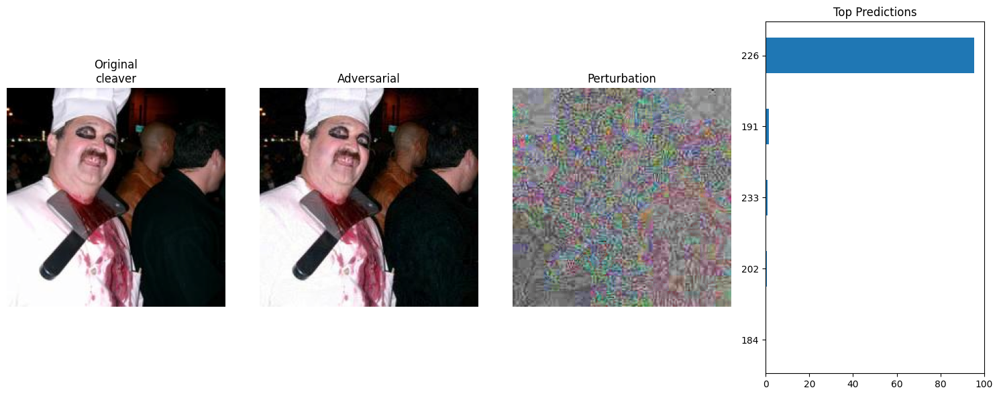

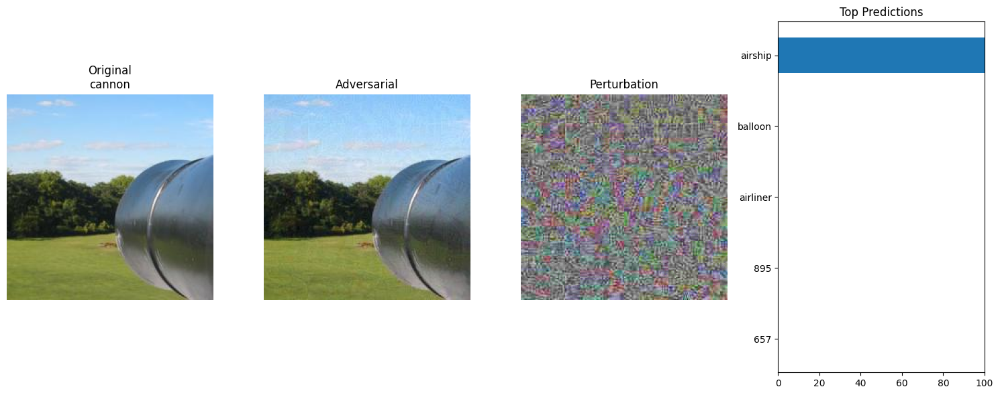

In [ ]:
print("\n=== Visualising images from original and adversarial datasets along with adversarial predictions ===")
visualize_adversarial_comparison(dataset, moment_fgsm_dataset, baseline_preds, moment_fgsm_preds, labels, label_map, n=3)

In [ ]:
# Task 3: Improved Attack (Moment Iterative FGSM)

print("\n=== Task 3: Moment Iterative FGSM Attack (ε=0.02) with alpha = 0.2 and interations as 10 ===")
epsilon = 0.02 
adv_images_moment_fgsm, original_paths, linf_values = mifgsm_attack(pretrained_model, data_loader, labels, epsilon=epsilon, alpha = 0.2, steps = 10)
save_adversarial_dataset(adv_images_moment_fgsm, original_paths, mean_norms, std_norms, "./AdversarialTestSet2-6")

# Evaluate pgd
moment_fgsm_dataset = torchvision.datasets.ImageFolder(root="./AdversarialTestSet2-6", transform=plain_transforms)
moment_fgsm_loader = DataLoader(moment_fgsm_dataset, batch_size=32, shuffle=False)
top1_moment_fgsm, top5_moment_fgsm, moment_fgsm_preds = evaluate(pretrained_model, moment_fgsm_loader, labels)

print(f"PGD Top-1 Accuracy: {top1_moment_fgsm*100:.2f}%")
print(f"PGD Top-5 Accuracy: {top5_moment_fgsm*100:.2f}%")
print(f"Maximum L Infinite distance: {linf_values.max().item():.3f}")


=== Task 3: Moment Iterative FGSM Attack (ε=0.02) with alpha = 0.2 and interations as 10 ===
PGD Top-1 Accuracy: 0.40%
PGD Top-5 Accuracy: 17.00%
Maximum L Infinite distance: 0.020



=== Visualising images from original and adversarial datasets along with adversarial predictions ===


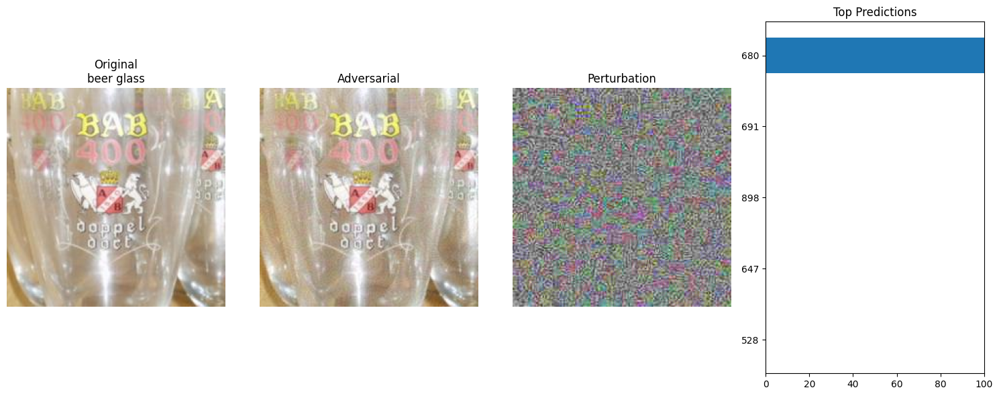

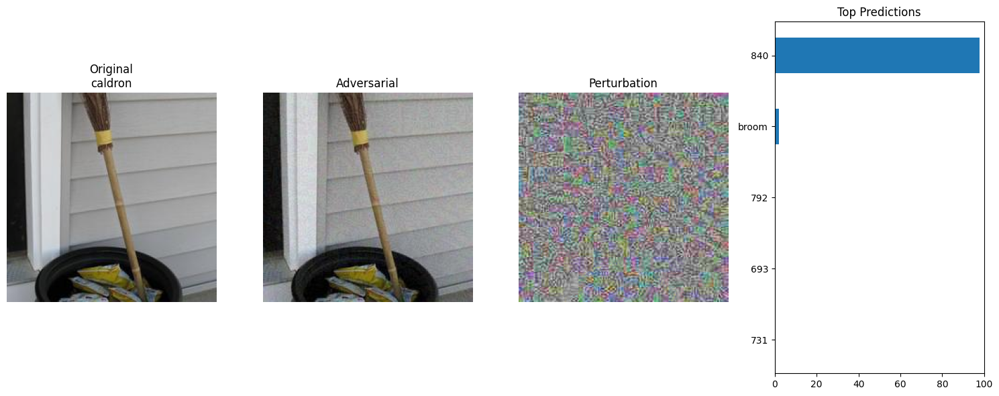

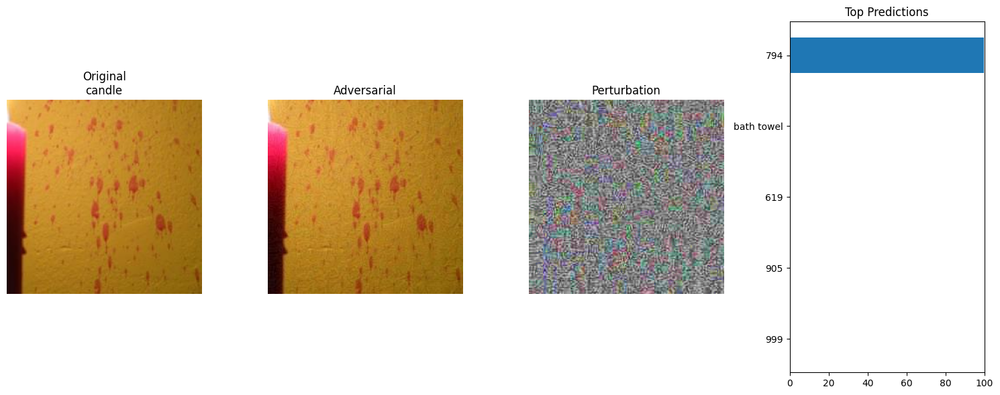

In [ ]:
print("\n=== Visualising images from original and adversarial datasets along with adversarial predictions ===")
visualize_adversarial_comparison(dataset, moment_fgsm_dataset, baseline_preds, moment_fgsm_preds, labels, label_map, n=3)

In [ ]:
# Task 3: Improved Attack (Moment Iterative FGSM)

print("\n=== Task 3: Moment Iterative FGSM Attack (ε=0.02) with alpha = 0.2 and interations as 10 ===")
epsilon = 0.02 
adv_images_moment_fgsm, original_paths, linf_values = mifgsm_attack(pretrained_model, data_loader, labels, epsilon=epsilon, alpha = 0.2, steps = 20)
save_adversarial_dataset(adv_images_moment_fgsm, original_paths, mean_norms, std_norms, "./AdversarialTestSet2-7")

# Evaluate pgd
moment_fgsm_dataset = torchvision.datasets.ImageFolder(root="./AdversarialTestSet2-7", transform=plain_transforms)
moment_fgsm_loader = DataLoader(moment_fgsm_dataset, batch_size=32, shuffle=False)
top1_moment_fgsm, top5_moment_fgsm, moment_fgsm_preds = evaluate(pretrained_model, moment_fgsm_loader, labels)

print(f"PGD Top-1 Accuracy: {top1_moment_fgsm*100:.2f}%")
print(f"PGD Top-5 Accuracy: {top5_moment_fgsm*100:.2f}%")
print(f"Maximum L Infinite distance: {linf_values.max().item():.3f}")


=== Task 3: Moment Iterative FGSM Attack (ε=0.02) with alpha = 0.2 and interations as 10 ===
PGD Top-1 Accuracy: 0.40%
PGD Top-5 Accuracy: 21.40%
Maximum L Infinite distance: 0.020



=== Visualising images from original and adversarial datasets along with adversarial predictions ===


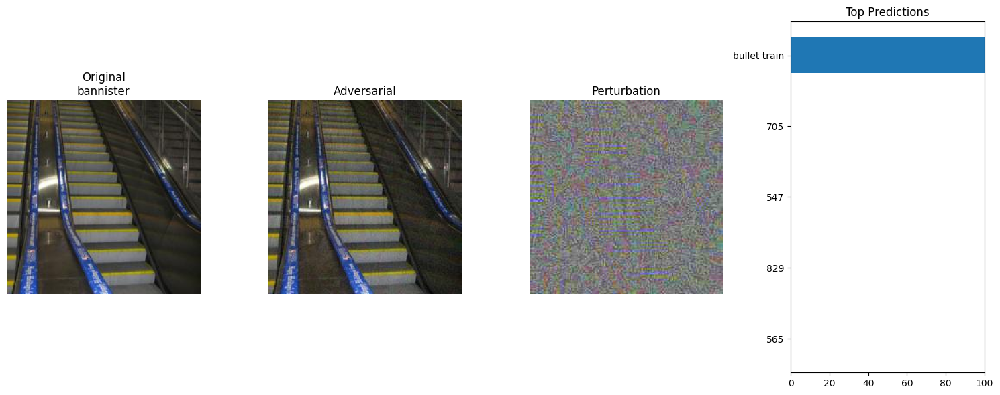

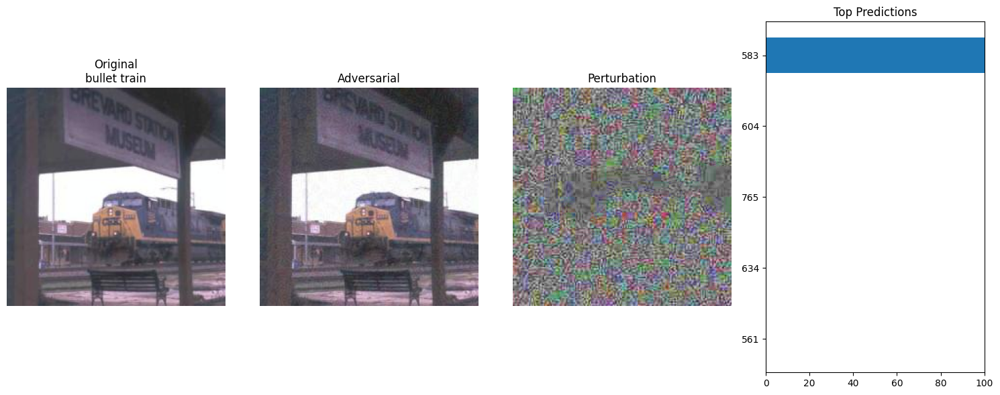

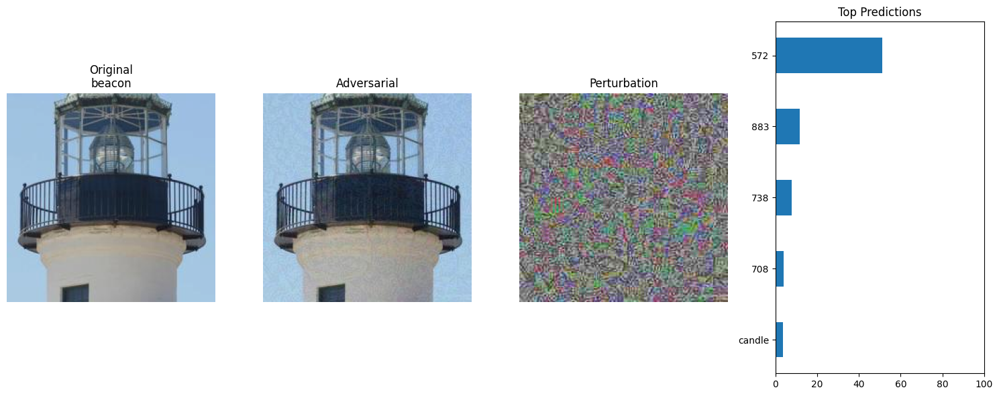

In [ ]:
print("\n=== Visualising images from original and adversarial datasets along with adversarial predictions ===")
visualize_adversarial_comparison(dataset, moment_fgsm_dataset, baseline_preds, moment_fgsm_preds, labels, label_map, n=3)

In [ ]:
# Task 3: Improved Attack (Moment Iterative FGSM)

print("\n=== Task 3: Moment Iterative FGSM Attack (ε=0.02) with alpha = 0.2 and interations as 10 ===")
epsilon = 0.02 
adv_images_moment_fgsm, original_paths, linf_values = mifgsm_attack(pretrained_model, data_loader, labels, epsilon=epsilon, alpha = 0.2, steps = 30)
save_adversarial_dataset(adv_images_moment_fgsm, original_paths, mean_norms, std_norms, "./AdversarialTestSet2-8")

# Evaluate pgd
moment_fgsm_dataset = torchvision.datasets.ImageFolder(root="./AdversarialTestSet2-8", transform=plain_transforms)
moment_fgsm_loader = DataLoader(moment_fgsm_dataset, batch_size=32, shuffle=False)
top1_moment_fgsm, top5_moment_fgsm, moment_fgsm_preds = evaluate(pretrained_model, moment_fgsm_loader, labels)

print(f"PGD Top-1 Accuracy: {top1_moment_fgsm*100:.2f}%")
print(f"PGD Top-5 Accuracy: {top5_moment_fgsm*100:.2f}%")
print(f"Maximum L Infinite distance: {linf_values.max().item():.3f}")


=== Task 3: Moment Iterative FGSM Attack (ε=0.02) with alpha = 0.2 and interations as 10 ===
PGD Top-1 Accuracy: 1.40%
PGD Top-5 Accuracy: 23.20%
Maximum L Infinite distance: 0.020



=== Visualising images from original and adversarial datasets along with adversarial predictions ===


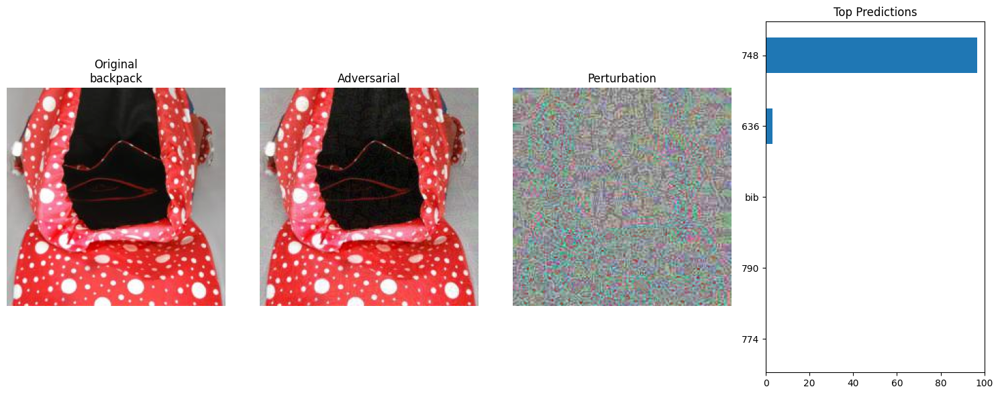

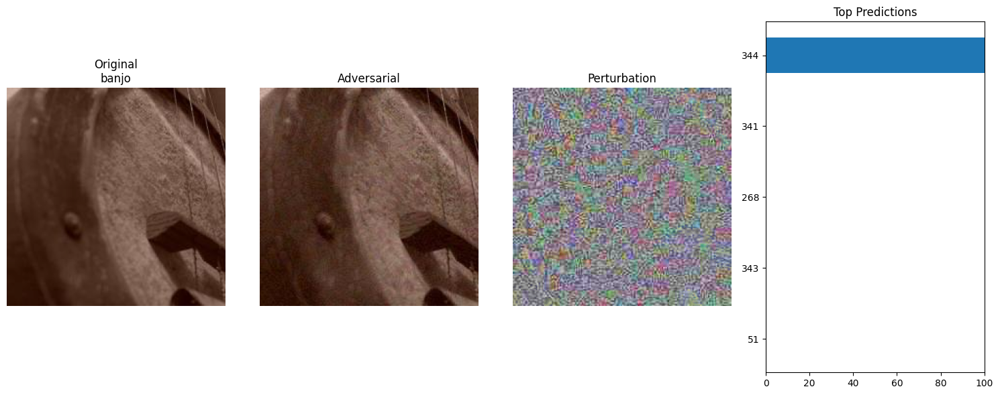

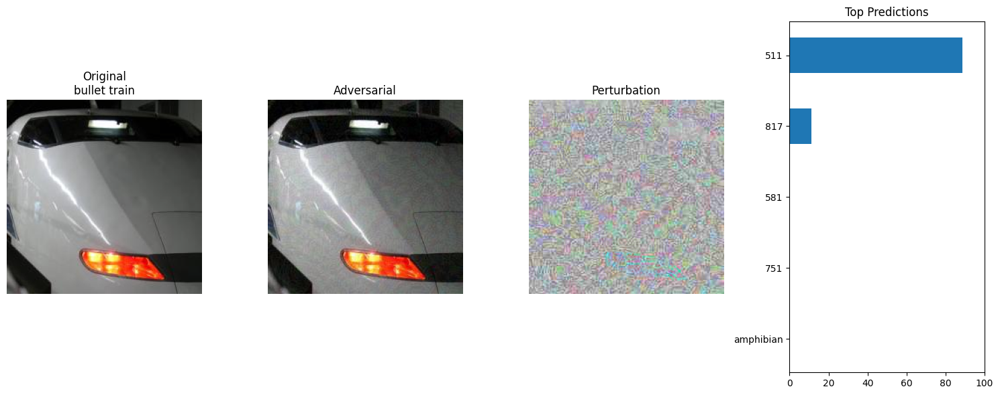

In [ ]:
print("\n=== Visualising images from original and adversarial datasets along with adversarial predictions ===")
visualize_adversarial_comparison(dataset, moment_fgsm_dataset, baseline_preds, moment_fgsm_preds, labels, label_map, n=3)

## Task 4: Patched Attacks

In [ ]:
class PatchMIFGSM(Attack):
    def __init__(self, model, eps=8/255, alpha=2/255, steps=10, decay=1.0, patch_size=32):
        super().__init__("PatchMIFGSM", model)
        self.eps = eps
        self.alpha = alpha
        self.steps = steps
        self.decay = decay
        self.patch_size = patch_size
        self.supported_mode = ["default", "targeted"]

    def forward(self, images, labels):
        images = images.clone().detach().to(self.device)
        labels = labels.clone().detach().to(self.device)
        batch_size, _, height, width = images.shape

        # Initialize perturbation and momentum
        delta = torch.zeros_like(images)
        momentum = torch.zeros_like(images)

        # Random patch location per image (fixed for all iterations)
        top = torch.randint(0, height - self.patch_size + 1, (batch_size,), device=self.device)
        left = torch.randint(0, width - self.patch_size + 1, (batch_size,), device=self.device)

        if self.targeted:
            target_labels = self.get_target_label(images, labels)

        for _ in range(self.steps):
            delta.requires_grad_(True)
            adv_images = images + delta
            outputs = self.get_logits(adv_images)
            loss = nn.CrossEntropyLoss()(outputs, target_labels if self.targeted else labels)

            grad = torch.autograd.grad(loss, delta, retain_graph=False, create_graph=False)[0]

            # Update only inside the patch for each image
            with torch.no_grad():
                for i in range(batch_size):
                    t, l = top[i].item(), left[i].item()
                    patch_grad = grad[i, :, t:t+self.patch_size, l:l+self.patch_size]
                    # Normalize patch gradient
                    patch_grad_norm = patch_grad / (patch_grad.abs().mean() + 1e-8)
                    # Update momentum only in patch
                    momentum[i, :, t:t+self.patch_size, l:l+self.patch_size] = \
                        self.decay * momentum[i, :, t:t+self.patch_size, l:l+self.patch_size] + patch_grad_norm
                    # Update delta only in patch
                    delta[i, :, t:t+self.patch_size, l:l+self.patch_size] += \
                        self.alpha * momentum[i, :, t:t+self.patch_size, l:l+self.patch_size].sign()

                # Project delta to Linf ball
                delta = torch.clamp(delta, -self.eps, self.eps)
                # Ensure valid pixel range [0, 1]
                delta = torch.clamp(images + delta, 0, 1) - images

            delta = delta.detach()

        return (images + delta).detach()

In [ ]:
def patch_mifgsm_attack(model, dataloader, labels, epsilon=0.02, alpha = 0.002, steps = 10, decay = 0.9, targeted = False):
    """Generate adversarial examples using Adam Optimized PGD attack 
    
    Args:
        model: Target model to attack
        dataloader: DataLoader containing the dataset to attack
        labels: Ground truth labels for the dataset
        epsilon: Perturbation magnitude (default: 0.02)
    """
    # Initialize FGSM attack with given parameters
    attack = PatchMIFGSM(model, eps=epsilon , steps=steps, alpha= alpha, decay=decay)
    attack.set_normalization_used(mean=mean, std=std)

    if targeted:
        attack.set_mode_targeted_by_label()
    
    # Storage for results
    adv_images = []
    original_paths = []  # Paths to original images
    orig_images = []     # Original images for reference
    l_inf_all_values = []  # L∞ distances for each example
    
    for batch_idx, (images, _) in enumerate(dataloader):
        # Preserve original paths if dataset provides them
        if hasattr(dataloader.dataset, 'samples'):
            start_idx = batch_idx * dataloader.batch_size
            end_idx = min((batch_idx+1)*dataloader.batch_size, len(dataloader.dataset))
            paths = [dataloader.dataset.samples[idx][0] for idx in range(start_idx, end_idx)]
            original_paths.extend(paths)
            
        # Move batch to device and get corresponding labels
        images = images.to(device)
        batch_labels = labels[start_idx:end_idx]
        batch_labels = torch.tensor(batch_labels).to(device)
        orig_images.append(images.cpu())

        # Generate adversarial examples for this batch
        adv_images_batch = attack(images, batch_labels)
        adv_images.append(adv_images_batch.cpu())

        # Calculate perturbation magnitudes (L∞ norm)
        l_inf_values = calculate_l_inf(images, adv_images_batch)
        l_inf_all_values.append(l_inf_values.cpu())
    
    # Combine all batches into single tensors
    return (
        torch.cat(adv_images, dim=0), 
        original_paths, 
        torch.cat(l_inf_all_values, dim=0)
    )

In [ ]:
#Task4 Patch Based attacks Using adam_pgd

print("\n=== Task 4: Patch Attack (ε=0.5) ===")
epsilon = 0.5
adv_images_adam_pgd_patched, original_paths, linf_values = patch_mifgsm_attack(pretrained_model, data_loader, labels, epsilon=epsilon, alpha=0.05, steps=30, targeted=False)
save_adversarial_dataset(adv_images_adam_pgd_patched, original_paths, mean_norms, std_norms, "./AdversarialTestSet3")

#Evaluate Patch Attack
patched_moment_fgsm_dataset = torchvision.datasets.ImageFolder(root="./AdversarialTestSet3", transform=plain_transforms)
patched_mifgsm_loader = DataLoader(patched_moment_fgsm_dataset, batch_size=32, shuffle=False)
top1_patched_mifgsm, top5_patched_mifgsm, patched_moment_fgsm_preds = evaluate(pretrained_model, patched_mifgsm_loader, labels)
print(f"Patched adam_pgd Top-1 Accuracy: {top1_patched_mifgsm*100:.2f}%")
print(f"Patched adam_pgd Top-5 Accuracy: {top5_patched_mifgsm*100:.2f}%")
print(f"Maximum L Infinite distance: {linf_values.max().item():.3f}")


=== Task 4: Patch Attack (ε=0.5) ===
Patched adam_pgd Top-1 Accuracy: 22.40%
Patched adam_pgd Top-5 Accuracy: 66.40%
Maximum L Infinite distance: 0.500


In [ ]:
print("\n=== Visualising images from original and adversarial datasets along with adversarial predictions ===")
visualize_adversarial_comparison(dataset, patched_moment_fgsm_dataset, baseline_preds, patched_moment_fgsm_preds, labels, label_map, n=3)

## Task 5: Checking Transferability of Attacks

In [ ]:
#Densenet Transferability

# Load pretrained model
densenet_model = torchvision.models.densenet121(weights='IMAGENET1K_V1').to(device)
densenet_model.eval()

Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /Users/anshsarkar/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth


100%|██████████| 30.8M/30.8M [00:01<00:00, 25.6MB/s]


DenseNet(
  (features): Sequential(
    (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu2): ReLU(inplace=True)
        (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      )
      (denselayer2): _DenseLayer(
        (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu

In [ ]:
print("=== Densenet Baseline Evaluation ===")
densenet_top1, densenet_top5, baseline_preds = evaluate(densenet_model, data_loader, labels)
print(f"Top-1 Accuracy: {densenet_top1*100:.2f}%")
print(f"Top-5 Accuracy: {densenet_top5*100:.2f}%")

=== Densenet Baseline Evaluation ===
Top-1 Accuracy: 74.80%
Top-5 Accuracy: 93.60%


In [ ]:
# Evaluate FGSM for densenet
fgsm_dataset = torchvision.datasets.ImageFolder(root="./AdversarialTestSet1", transform=plain_transforms)
fgsm_loader = DataLoader(fgsm_dataset, batch_size=32, shuffle=False)
top1_fgsm, top5_fgsm, fgsm_preds = evaluate(densenet_model, fgsm_loader, labels)
print(f"FGSM Top-1 Accuracy Densenet: {top1_fgsm*100:.2f}%")
print(f"FGSM Top-5 Accuracy Densenet: {top5_fgsm*100:.2f}%")

FGSM Top-1 Accuracy Densenet: 49.20%
FGSM Top-5 Accuracy Densenet: 77.40%


In [ ]:
# Evaluate MIFGSM for densenet
mifgsm_dataset = torchvision.datasets.ImageFolder(root="./AdversarialTestSet2", transform=plain_transforms)
mifgsm_loader = DataLoader(mifgsm_dataset, batch_size=32, shuffle=False)
top1_mifgsm, top5_mifgsm, mifgsm_preds = evaluate(densenet_model, mifgsm_loader, labels)
print(f"MIFGSM Top-1 Accuracy Densenet: {top1_mifgsm*100:.2f}%")
print(f"MIFGSM Top-5 Accuracy Densenet: {top5_mifgsm*100:.2f}%")

MIFGSM Top-1 Accuracy Densenet: 55.60%
MIFGSM Top-5 Accuracy Densenet: 84.20%


In [ ]:
#Evaluate Patch Attack for densenet
patched_mifgsm_dataset = torchvision.datasets.ImageFolder(root="./AdversarialTestSet3", transform=plain_transforms)
patched_mifgsm_loader = DataLoader(patched_mifgsm_dataset, batch_size=32, shuffle=False)
top1_patched_mifgsm, top5_patched_mifgsm, patched_mifgsm_preds = evaluate(densenet_model, patched_mifgsm_loader, labels)
print(f"Patched MIFGSM Top-1 Accuracy Densenet: {top1_patched_mifgsm*100:.2f}%")
print(f"Patched MIFGSM Top-5 Accuracy Densenet: {top5_patched_mifgsm*100:.2f}%")

Patched MIFGSM Top-1 Accuracy Densenet: 68.40%
Patched MIFGSM Top-5 Accuracy Densenet: 90.80%
